# Metric comparison with expert asessment
## Dataset 1

Metric compuation procedure is described in [Metric for evaluating difference between seismograms](./Metrics_study_intro.ipynb)

In [1]:
import sys
sys.path.append('..')

import pandas as pd

from functools import reduce

from seismicpro.batchflow import Dataset
from seismicpro.src import SeismicBatch, FieldIndex

from utils import get_cv, draw_modifications_dist, validate_all, get_modifications_list

## Loading data

In [2]:
base_path = '/datasets/Metrix_QC/' 
      
paths = {
    'lift': '2_QC_Metrix-4.sgy', 
    'raw': '2_QC_Metrix_1.sgy',
    'm_1': '2_QC_Metrix-2.sgy',
    'm_2': '2_QC_Metrix-3.sgy',
    'm_3': '2_QC_Metrix-5.sgy',
}

field_index = reduce(lambda x, y: x.merge(y), 
                     (FieldIndex(name=name, path=base_path+path, extra_headers=['offset']) for name, path in paths.items()))


batch = (Dataset(field_index, SeismicBatch)
         .next_batch(len(field_index))
         .load(fmt='segy', components=tuple(paths.keys())))

cv = get_cv([batch.__getattr__(c)[0] for c in batch.components])

print("Number of fields: {}".format(len(field_index)))

Number of fields: 10


## Metrics calculation with lift as base

On all fields expert rate M_1 as the worst model and M_3 as the best one

In [8]:
res = validate_all(batch)
df = pd.DataFrame(res)
df["agrees with experts"] = (df.M_1 > df.M_2) & (df.M_2 > df.M_3)
df

,LIFT,M_1,M_2,M_3,RAW,agrees with experts
0,0.0,8.447589,3.041750,0.481176,21.984201,True
1,0.0,51.116924,18.735985,0.507837,23.778841,True
2,0.0,12.228881,5.123900,0.458287,27.620659,True
3,0.0,39.678970,16.409073,0.496214,31.869478,True
4,0.0,23.544403,10.454869,0.980383,77.799500,True
5,0.0,27.295153,10.714234,0.707443,48.290840,True
6,0.0,33.277679,11.075420,0.743712,55.999084,True
7,0.0,27.238365,10.653739,0.704853,28.500233,True
8,0.0,50.642151,24.989122,0.706606,21.853453,True
9,0.0,27.400826,9.534584,0.748651,39.058048,True


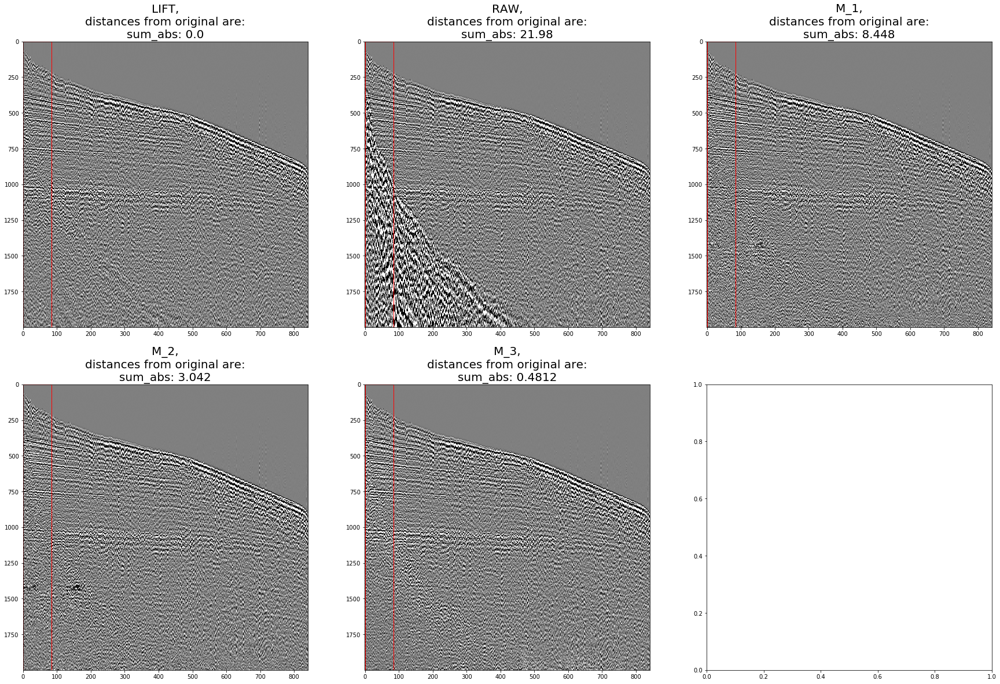

In [9]:
i=0
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

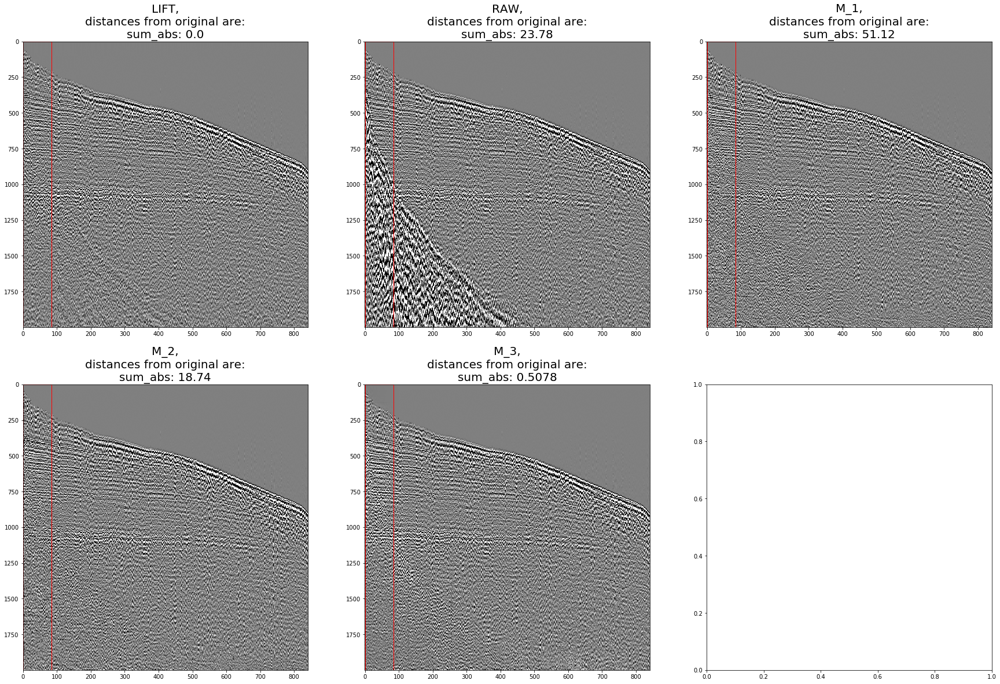

In [10]:
i=1
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

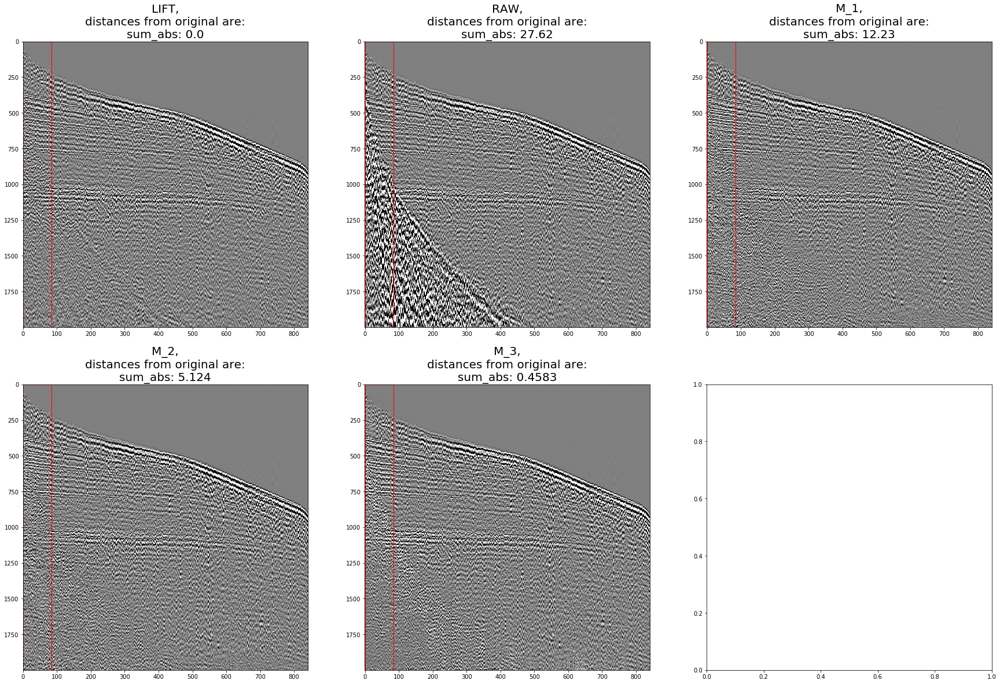

In [11]:
i=2
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

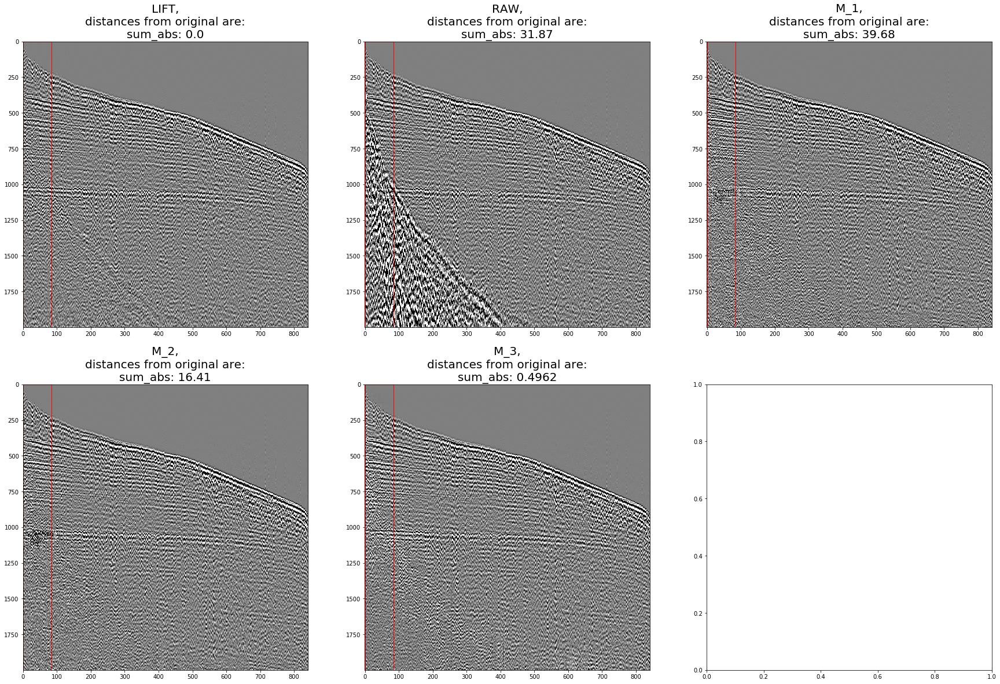

In [12]:
i=3
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

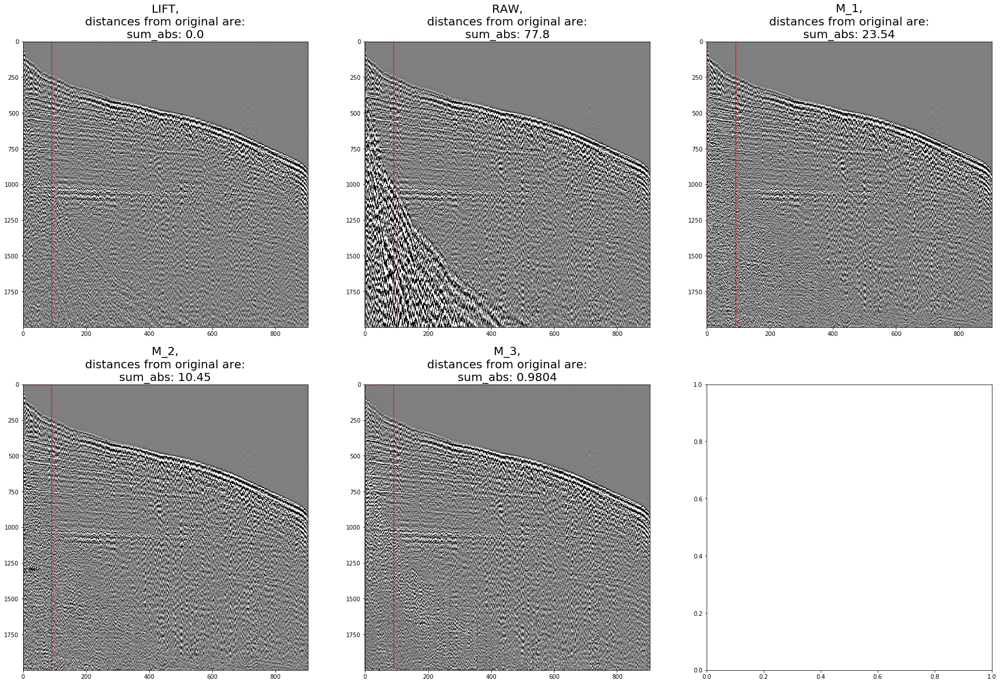

In [13]:
i=4
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

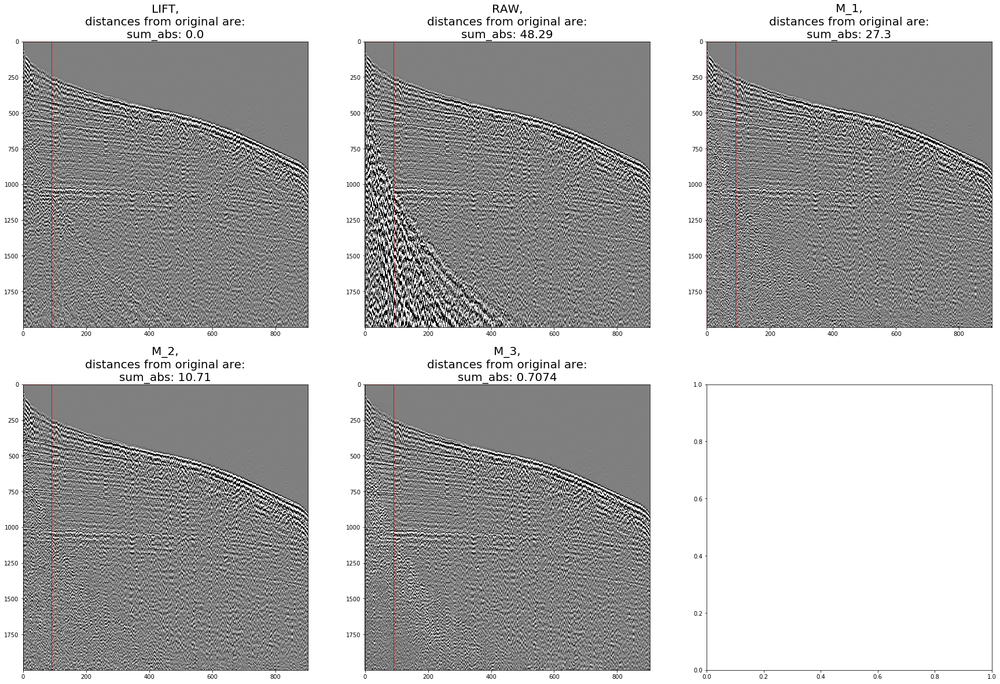

In [14]:
i=5
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

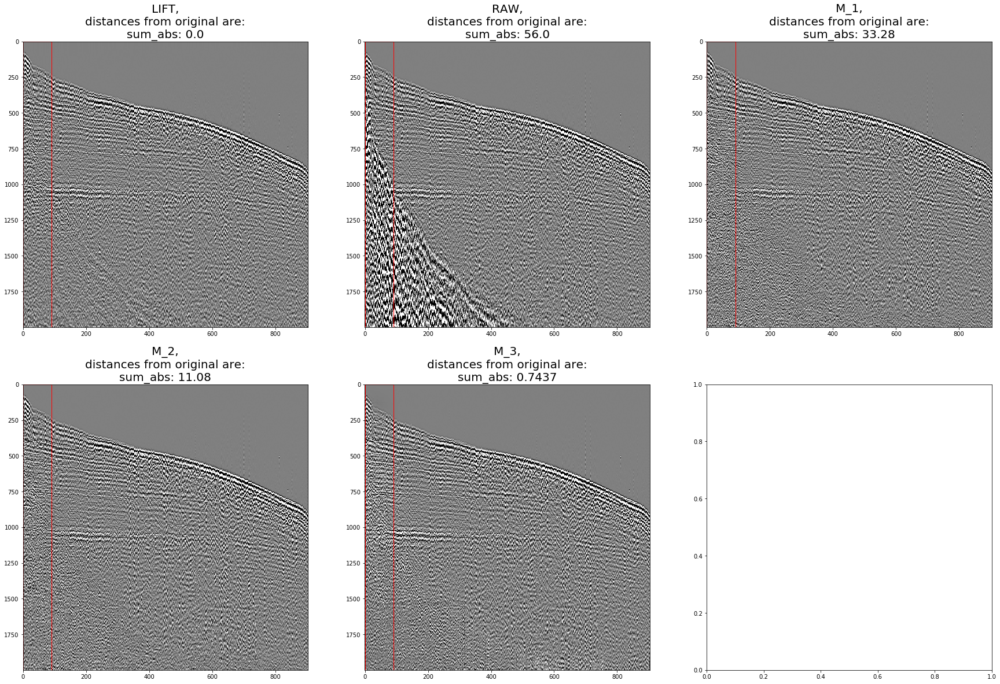

In [15]:
i=6
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

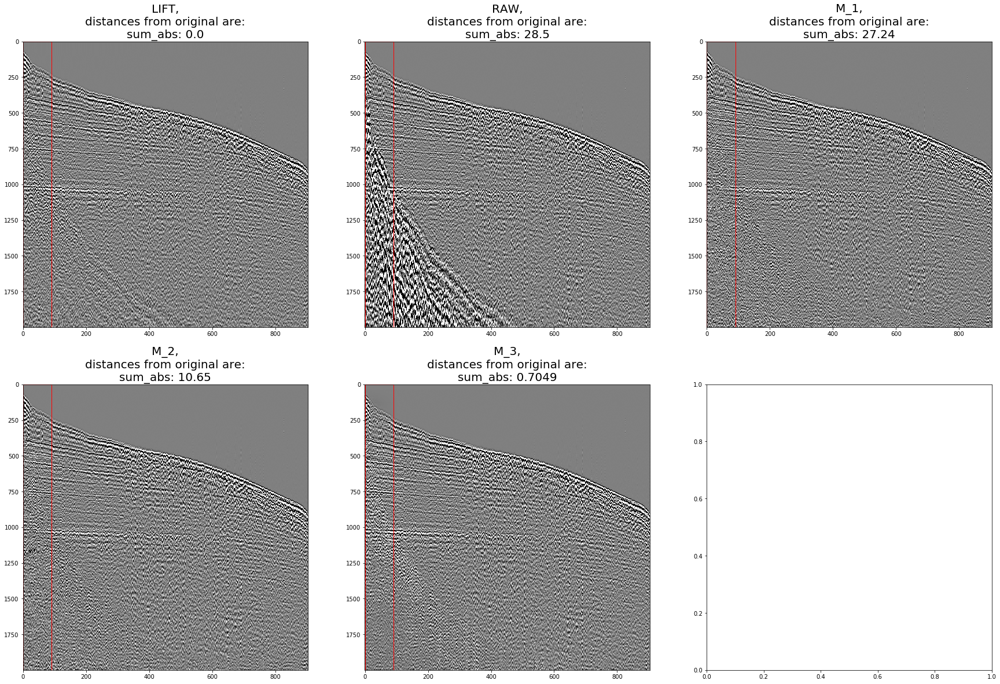

In [16]:
i=7
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

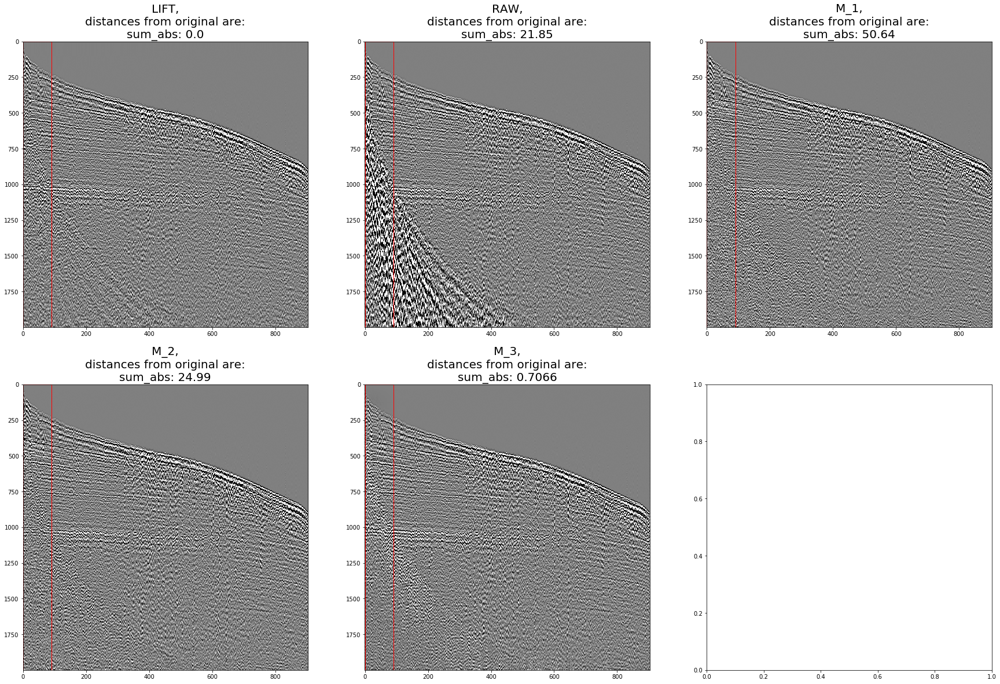

In [17]:
i=8
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

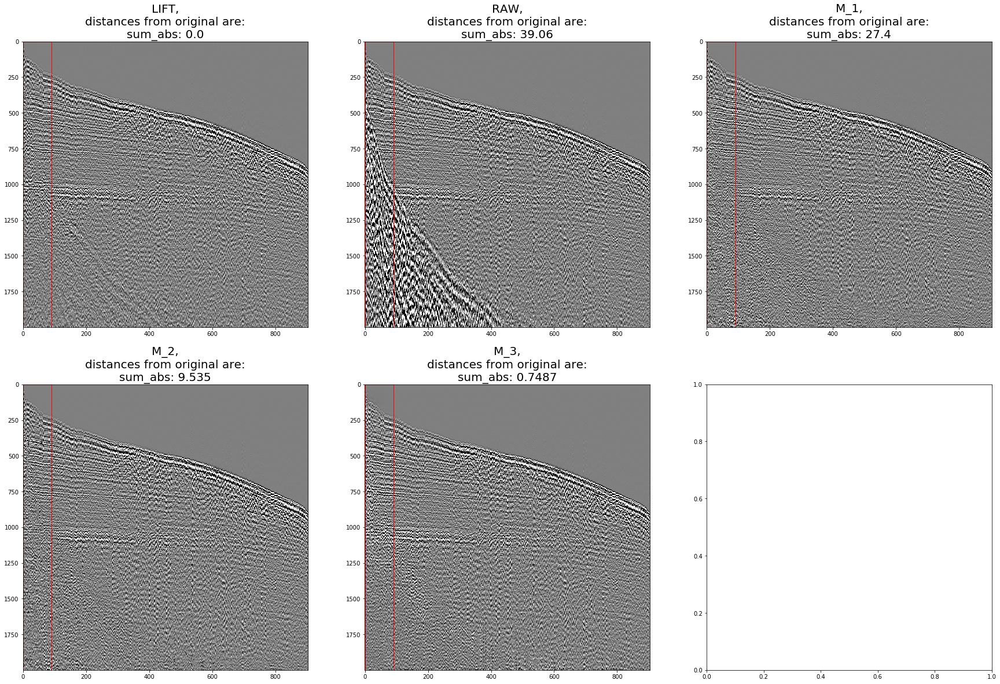

In [18]:
i=9
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')